# PRIORITIZATION OF PRODUCTION LINES FOR PROJECTS IN 2021 AND 2022 -ADR CASE STUDY-

## Context of the problem 

The Rural Development Agency - ADR- is the entity responsible for managing, promoting, and financing agricultural and rural development for the transformation of the Colombian countryside and carrying out programs with regional impact. Through its initiative, ADR offers the services that the agricultural community needs to make the land productive and improve the living conditions of rural people.

Thus, the ADR calls for co-financing agricultural production projects and takes on the challenge of defining the guidelines and variables with which the projects must be evaluated to generate a greater impact in the field at the national level. ADR does not only pursue financial outcomes of the projects but also cares about projects which have a social impact in the communities.

## Business problem

Define which production lines should be prioritized in the selection of agricultural projects for the year 2021 and 2022 in Colombia, considering the impact generated by COVID-19 and the effects of the drop in oil.

In [1]:
# Import required libraries
import math
import datetime as dt
import pandas as pd
import pathlib
import pandas as pd
import numpy as np
import csv
from sklearn import preprocessing
import gzip
import json
import string

import nltk # imports the natural language toolkit
import plotly as px
import matplotlib.pyplot as plt

import nltk # imports the natural language toolkit
nltk.download('punkt')
nltk.download('stopwords')
import string
import plotly
from nltk.stem import PorterStemmer 
from sklearn.feature_extraction.text import CountVectorizer

import io 
from nltk.corpus import stopwords 
from nltk.tokenize import word_tokenize

from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans

[nltk_data] Downloading package punkt to C:\Users\Carlos Loaiza
[nltk_data]     Velez\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to C:\Users\Carlos Loaiza
[nltk_data]     Velez\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [2]:
# Load data
# get relative data folder
PATH = pathlib.Path('./data').parent
DATA_PATH = PATH.joinpath("data").resolve()
PIDAR = pd.read_csv(DATA_PATH.joinpath("pidar.csv"))
EVA = pd.read_csv(DATA_PATH.joinpath('EVA_cultivos_modificado.csv'))

#Aptitude per productive chain 
SIPRA = pd.read_csv(DATA_PATH.joinpath("data_sipra_normalizado.csv"))

#Historico de proyectos PIDAR desde el 2015
IPDR = pd.read_csv(DATA_PATH.joinpath("reporte_proyectos_IPDR.csv"), sep = ';',thousands='.')

## Text preprocessing

At the beginning we don't have the production chain per projects so we need to extract these features from the project name

In [3]:
vec = CountVectorizer()

nltk.download('punkt')

CP_ADR = EVA['CADENA_PRODUCTIVA_ADR'].unique()

[nltk_data] Downloading package punkt to C:\Users\Carlos Loaiza
[nltk_data]     Velez\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


In [4]:
def clean_text(text):
    # lower text
    text = text.lower()
    # tokenize text and remove puncutation
    text = [word.strip(string.punctuation) for word in text.split(" ")]
    # remove words that contain numbers
    text = [word for word in text if not any(c.isdigit() for c in word)]
    # remove stop words
    stop = stopwords.words('spanish')
    text = [x for x in text if x not in stop]
    # remove empty tokens
    text = [t for t in text if len(t) > 0]
    # remove words with only one letter
    text = [t for t in text if len(t) > 1]
    # join all
    text = " ".join(text)
    return(text)

In [5]:
def normalize(s):
    replacements = (
        ("á", "a"),
        ("é", "e"),
        ("í", "i"),
        ("ó", "o"),
        ("ú", "u"),
    )
    for a, b in replacements:
        s = s.replace(a, b).replace(a.upper(), b.upper())
    
    s = s.upper()
    return s    

In [6]:
# clean text data
PIDAR['TITULO'] = PIDAR['Nombre Proyecto'].apply(lambda x: clean_text(x))

In [7]:
new_df_PIDAR = []
for i in PIDAR['TITULO'].unique():
    list_w = i.split(" ")
    temp = PIDAR[PIDAR['TITULO']==i].copy()
    for j in list_w:
        w = normalize(j)
        if w in CP_ADR:
            temp['CADENA_PRODUCTIVA_ADR']=w
            new_df_PIDAR.append(temp)
            
new_df_PIDAR=pd.concat(new_df_PIDAR)
new_df_PIDAR.shape

(105, 25)

Extraction of the description of the projects for the identification of the productive chain to which it belongs

In [8]:
PIDAR_clean = []

for i in new_df_PIDAR['Municipio'].unique():
    temp = new_df_PIDAR[new_df_PIDAR['Municipio']==i].copy()

# Construction of indicators for crops from the EVA

In [9]:
EVA2 = EVA.groupby(['DEPARTAMENTO','CADENA_PRODUCTIVA_ADR'])[['AREA_SEMBR','AREA_COSECH','PRODUCCION','RENDIMIENTO']].mean().reset_index()
EVA2.columns = ['Departamento','CADENA_PRODUCTIVA_ADR','AREA_SEMBR','AREA_COSECH','PRODUCCION','RENDIMIENTO']
EVA2.head()

,Departamento,CADENA_PRODUCTIVA_ADR,AREA_SEMBR,AREA_COSECH,PRODUCCION,RENDIMIENTO
0,AMAZONAS,ACHICORIA,4.000000,4.000000,4.000000,1.000000
1,AMAZONAS,AGUACATE,21.875000,14.125000,84.125000,5.752500
2,AMAZONAS,AGUAJE,25.611111,18.666667,234.833333,11.279444
3,AMAZONAS,AHUYAMA,11.333333,11.333333,43.000000,3.793333
4,AMAZONAS,AJI,9.294118,8.558824,6.500000,0.807059


In [10]:
PRUEBA = pd.merge(new_df_PIDAR, EVA2, on = ['Departamento','CADENA_PRODUCTIVA_ADR'],how='left')
PRUEBA.head()

,Unnamed: 0,Unnamed: 0.1,BP,No. VP,Nombre Proyecto,Departamento,Municipio,Total beneficiarios,Hombres,Mujeres,...,Vigencia,Lineamiento de consejo directivo,AP_ID_ADR,AP_CADENA_PRODUCTIVA_ADR,TITULO,CADENA_PRODUCTIVA_ADR,AREA_SEMBR,AREA_COSECH,PRODUCCION,RENDIMIENTO
0,5,5,6,6,Mejorar las capacidades técnicas de adecuación...,CHOCO,CARMEN DEL DARIÉN,35,30,5,...,2017,NaN,1,AGRICOLA,mejorar capacidades técnicas adecuación siembr...,PLATANO,739.367403,616.287293,5346.646409,6.472403
1,16,16,17,17,Fortalecer la capacidad productiva y manejo de...,META,MESETAS,40,31,9,...,2017,NaN,1,AGRICOLA,fortalecer capacidad productiva manejo poscose...,CAFE,239.132075,194.056604,187.836478,0.845419
2,22,22,23,23,Fortalecer la cadena productiva de café y plát...,ANTIOQUIA,DABEIBA,25,20,5,...,2017,NaN,1,AGRICOLA,fortalecer cadena productiva café plátano trav...,PLATANO,595.321513,541.525611,3886.661939,5.423447
3,22,22,23,23,Fortalecer la cadena productiva de café y plát...,ANTIOQUIA,DABEIBA,25,20,5,...,2017,NaN,1,AGRICOLA,fortalecer cadena productiva café plátano trav...,PLATANO,595.321513,541.525611,3886.661939,5.423447
4,24,24,25,25,Fortalecimiento de la productividad del cultiv...,META,LA MACARENA,28,16,12,...,2017,NaN,1,AGRICOLA,fortalecimiento productividad cultivo caucho i...,CAUCHO,780.493151,80.100457,126.735160,1.576149


In [11]:
PRUEBA = PRUEBA.drop(["Unnamed: 0","Unnamed: 0.1"], axis=1)

## Analysis by variable

We want to understant the variation of the productive chain for each year and department

In [12]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots
fig = make_subplots(rows=3, cols=2)


trace2 = go.Histogram(x=PRUEBA["Total beneficiarios"], name="Total beneficiarios")
trace3 = go.Histogram(x=PRUEBA["Valor cofinanciado ADR"],name="Valor cofinanciado ADR")
trace4 = go.Histogram(x=PRUEBA["Valor total proyecto"],name="Valor total proyecto")
trace5 = go.Histogram(x=PRUEBA["Hectáreas"], name="Hectáreas")
trace8 = go.Histogram(x=PRUEBA["PRODUCCION"],name="Producción")
trace9 = go.Histogram(x=PRUEBA["RENDIMIENTO"], name="Rendimiento")

fig.append_trace(trace9, 1, 1)
fig.append_trace(trace2, 1, 2)
fig.append_trace(trace3, 2, 1)
fig.append_trace(trace4, 2, 2)
fig.append_trace(trace5, 3, 1)
fig.append_trace(trace8, 3, 2)
fig.show()

In [13]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots
fig = make_subplots(rows=1, cols=3)

trace1 = go.Histogram(x=PRUEBA["Departamento"],name="Departamento")
trace6 = go.Histogram(x=PRUEBA["Vigencia"],name="Vigencia")
trace7 = go.Histogram(x=PRUEBA["CADENA_PRODUCTIVA_ADR"], name="Cadena Productiva")

fig.append_trace(trace6, 1, 1)
fig.append_trace(trace7, 1, 2)
fig.append_trace(trace1, 1, 3)
fig.show()

In [14]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots
fig = make_subplots(rows=1, cols=3)

trace1 = go.Histogram(x=EVA["DEPARTAMENTO"],name="Departamento")
trace6 = go.Histogram(x=EVA["YEAR"],name="Year")
trace7 = go.Histogram(x=EVA["CADENA_PRODUCTIVA_ADR"], name="Cadena Productiva")

fig.append_trace(trace6, 1, 1)
fig.append_trace(trace7, 1, 2)
fig.append_trace(trace1, 1, 3)

fig.show()

## Analysis by production chain

Analysis by production chain based on the co-financed value, performance, productivity and total beneficiaries

In [15]:
import plotly.express as px
fig = px.scatter(PRUEBA, x='RENDIMIENTO', y='Valor total cofinanciación ADR', color='CADENA_PRODUCTIVA_ADR',
                 size='Total beneficiarios', hover_data=['BP','Departamento','Vigencia'], title = 'Valor confinanciado vs rendimiento por proyecto')
fig.show()

## Creation of the aptitude index by department

In [17]:
SIPRA['Indice']=SIPRA['Total aptitud [ha]']/SIPRA['Área departamento [ha]']
SIPRA_df = SIPRA.drop(SIPRA[SIPRA['Indice']>0.999].index)
SIP_df = SIPRA_df.pivot_table(index='Departamento', columns='Cultivo', values='Indice')
SIP_df

Cultivo,AGUACATE,ARROZ,BANANO,CACAO,CAUCHO,CEBOLLA,FRESA,MANGO,PALMA DE ACEITE,PAPA,PAPAYA
Departamento,,,,,,,,,,,
AMAZONAS,0.000000e+00,0.001238,0.000000,0.001077,0.001017,0.000012,0.000000e+00,0.001035,0.001845,0.000000,0.001132
ANTIOQUIA,1.102803e-01,0.100773,0.054626,0.223425,0.226745,0.239013,7.752173e-02,0.218506,0.190738,0.014999,0.167340
ARAUCA,0.000000e+00,0.269773,0.000003,0.153198,0.151334,0.164807,0.000000e+00,0.027042,NaN,0.000000,0.026776
ARCHIPIELAGO DE SAN ANDRES PROVIDENCIA Y SANTA CATALINA,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000,0.000000,0.000000
ATLANTICO,0.000000e+00,0.000000,0.493440,0.397250,0.342204,0.475421,0.000000e+00,0.451620,0.563796,0.000000,0.389746
BOLIVAR,1.108612e-03,0.086325,0.115314,0.203833,0.190508,0.239741,1.017447e-03,0.184260,0.247802,0.000000,0.178086
BOYACA,1.558698e-01,0.017875,0.011469,0.102191,0.100875,0.212946,1.707964e-01,0.069662,0.049288,0.085246,0.055411
CALDAS,1.613263e-01,0.054731,0.066371,0.283917,0.290492,0.383866,1.431018e-01,0.264062,0.170428,0.041853,0.180715
CAQUETA,2.585779e-05,0.062899,0.000262,0.131381,0.128249,0.061807,7.835022e-05,0.115714,0.131872,0.000000,0.113868


## Assign the production chain by IPDR project data set

In [18]:
IPDR.columns = ['YEAR', 'Proyecto', 'DEPARTAMENTO','MUNICIPIO',
       'Número Resolución', 'Fecha resolución', 'familias_campesinas',
       'familias_desplazadas', 'familias_indigenas', 'familias_negritudes',
       'familias_mujer_cabeza', 'familias_rom', 'Valor total',
       'Valor contrapartidas certificadas', 'Recursos propios',
       'Valor cofinanciación', 'Valor desembolsado', 'Formulador', 'Evaluador',
       'Formulacion', 'Evaluacion', 'Resolución generada',
       'Resolución cargada', 'Desembolsado totalmente']

In [19]:
print(IPDR.shape)

(943, 24)


In [20]:
IPDR['DEPARTAMENTO'] = IPDR['DEPARTAMENTO'].replace('NARINO', 'NARIÃ‘O')
IPDR['DEPARTAMENTO'] = IPDR['DEPARTAMENTO'].replace('CHOCÓ', 'CHOCO')

In [21]:
EVA2 = EVA.groupby(['DEPARTAMENTO','CADENA_PRODUCTIVA_ADR','MUNICIPIO','YEAR'])[['AREA_SEMBR','AREA_COSECH','PRODUCCION','RENDIMIENTO']].mean().reset_index()
EVA2.columns = ['DEPARTAMENTO','CADENA_PRODUCTIVA_ADR','MUNICIPIO','YEAR','AREA_SEMBR','AREA_COSECH','PRODUCCION','RENDIMIENTO']
EVA2.head()

,DEPARTAMENTO,CADENA_PRODUCTIVA_ADR,MUNICIPIO,YEAR,AREA_SEMBR,AREA_COSECH,PRODUCCION,RENDIMIENTO
0,AMAZONAS,ACHICORIA,LETICIA,2007,2.0,2.0,2.0,1.00
1,AMAZONAS,ACHICORIA,LETICIA,2008,3.0,3.0,3.0,1.00
2,AMAZONAS,ACHICORIA,PUERTO NARIÑO,2007,4.0,4.0,4.0,1.00
3,AMAZONAS,ACHICORIA,PUERTO NARIÑO,2008,6.0,6.0,6.0,1.00
4,AMAZONAS,AGUACATE,LETICIA,2008,38.0,15.0,94.0,6.27


In [22]:
CL1 = EVA2.pivot_table(index=['DEPARTAMENTO','MUNICIPIO','YEAR'], columns='CADENA_PRODUCTIVA_ADR', values='RENDIMIENTO').reset_index()
CL1 = CL1.fillna(0)

In [23]:
CL2 = CL1
cols = ['DEPARTAMENTO','MUNICIPIO','YEAR']

In [24]:
#advertencia for infinito CUIDADO RIESGO DE RAM
maxs = {}
for i in range(0,len(CL2)):
    b = CL2[CL2.columns.difference(cols)].iloc[i]
    c = b.iloc[b .to_numpy().nonzero()].sort_values(ascending=False).head(5).keys()
    maxs.update({i:c})

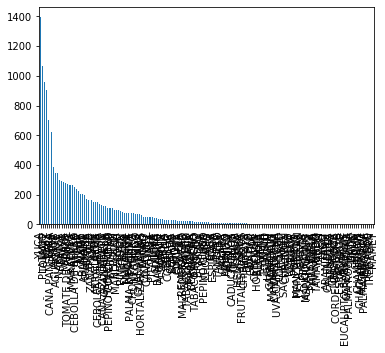

In [25]:
import random
PRUEBA5 = CL1[['DEPARTAMENTO', 'MUNICIPIO', 'YEAR']].copy()
PRUEBA5['CP'] = 'a'
for j in range(0,len(maxs)):
    d = maxs[j].values
    PRUEBA5.loc[j,'CP']=random.choice(d)

PRUEBA5['CP'].value_counts().plot.bar()

In [26]:
PRUEBA3 = pd.merge(IPDR, PRUEBA5, on = ['YEAR','DEPARTAMENTO','MUNICIPIO'],how='left')
print(PRUEBA3.shape)
PRUEBA3.head()

(943, 25)


,YEAR,Proyecto,DEPARTAMENTO,MUNICIPIO,Número Resolución,Fecha resolución,familias_campesinas,familias_desplazadas,familias_indigenas,familias_negritudes,...,Valor cofinanciación,Valor desembolsado,Formulador,Evaluador,Formulacion,Evaluacion,Resolución generada,Resolución cargada,Desembolsado totalmente,CP
0,2015,PDR15-VAL-TUL-03-C,VALLE DEL CAUCA,TULUA,6805.0,25/11/2015,5,0,0,0,...,40000000,40000000,Oscar Mario Ortiz,ANDRES LEONARDO FORERO,Si,Si,Si,SI,Si,REPOLLO
1,2015,PDR15-VAL-GUA-02-C,VALLE DEL CAUCA,GUADALAJARA DE BUGA,6947.0,24/11/2015,5,0,0,0,...,40000000,40000000,Oscar Mario Ortiz,ANDRES LEONARDO FORERO,Si,Si,Si,SI,Si,NaN
2,2015,PDR15-VAL-GUA-01-D,VALLE DEL CAUCA,GUADALAJARA DE BUGA,4193.0,5/08/2015,0,13,0,0,...,200928000,200928000,Oscar Mario Ortiz,ANDRES LEONARDO FORERO,Si,Si,Si,SI,Si,NaN
3,2015,PDR15-VAL-GIN-06-C,VALLE DEL CAUCA,GINEBRA,6804.0,25/11/2015,5,0,0,0,...,40000000,40000000,Oscar Mario Ortiz,ANDRES LEONARDO FORERO,Si,Si,Si,SI,Si,CAÑA AZUCARERA
4,2015,PDR15-VAL-BUG-05-C,VALLE DEL CAUCA,BUGALAGRANDE,6946.0,27/11/2015,5,0,0,0,...,40000000,40000000,Oscar Mario Ortiz,ANDRES LEONARDO FORERO,Si,Si,Si,SI,Si,MARACUYA


YUCA               86
ÑAME               69
TOMATE             53
PLATANO            51
PIÑA               39
                   ..
QUINUA              1
PITAHAYA            1
MAMEY               1
PEPINO COHOMBRO     1
GULUPA              1
Name: CP, Length: 64, dtype: int64


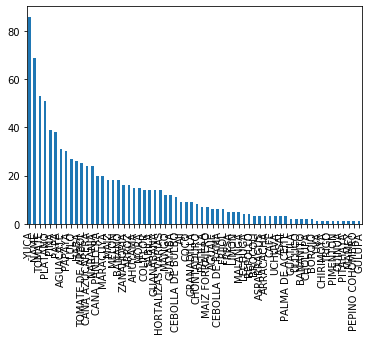

In [27]:
print(PRUEBA3['CP'].value_counts())
PRUEBA3['CP'].value_counts().plot.bar()

In [28]:
PRUEBA6 = PRUEBA3[PRUEBA3['CP'].isna()].copy()
PRUEBA6 = PRUEBA6.drop(columns = ['CP'])
PRUEBA6.shape

(43, 24)

In [29]:
PRUEBA9 = PRUEBA3.dropna(subset = ['CP'])
PRUEBA9.shape

(900, 25)

In [30]:
EVA2 = EVA.groupby(['DEPARTAMENTO','CADENA_PRODUCTIVA_ADR'])[['AREA_SEMBR','AREA_COSECH','PRODUCCION','RENDIMIENTO']].mean().reset_index()
EVA2.columns = ['DEPARTAMENTO','CADENA_PRODUCTIVA_ADR','AREA_SEMBR','AREA_COSECH','PRODUCCION','RENDIMIENTO']
CL3 = EVA2.pivot_table(index=['DEPARTAMENTO'], columns='CADENA_PRODUCTIVA_ADR', values='RENDIMIENTO').reset_index()
CL3 = CL3.fillna(0)

In [31]:
#advertencia for infinito CUIDADO RIESGO DE RAM
maxs2 = {}
for i in range(0,len(CL3)):
    b = CL3[CL3.columns.difference(cols)].iloc[i]
    c = b.iloc[b .to_numpy().nonzero()].sort_values(ascending=False).head(5).keys()
    maxs2.update({i:c})

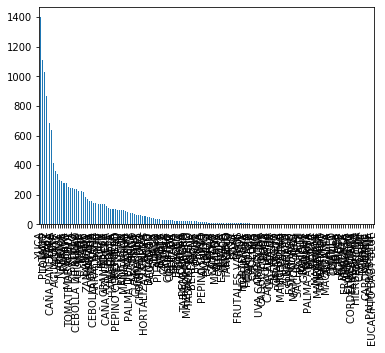

In [32]:
import random
PRUEBA7 = CL3[['DEPARTAMENTO']].copy()
PRUEBA7['CP'] = 'a'
for j in range(0,len(maxs)):
    d = maxs[j].values
    PRUEBA7.loc[j,'CP']=random.choice(d)

PRUEBA7['CP'].value_counts().plot.bar()

In [33]:
PRUEBA8 = pd.merge(PRUEBA6, PRUEBA7, on = ['DEPARTAMENTO'],how='left')
print(PRUEBA8.shape)
PRUEBA8.head()

(43, 25)


,YEAR,Proyecto,DEPARTAMENTO,MUNICIPIO,Número Resolución,Fecha resolución,familias_campesinas,familias_desplazadas,familias_indigenas,familias_negritudes,...,Valor cofinanciación,Valor desembolsado,Formulador,Evaluador,Formulacion,Evaluacion,Resolución generada,Resolución cargada,Desembolsado totalmente,CP
0,2015,PDR15-VAL-GUA-02-C,VALLE DEL CAUCA,GUADALAJARA DE BUGA,6947.0,24/11/2015,5,0,0,0,...,40000000,40000000,Oscar Mario Ortiz,ANDRES LEONARDO FORERO,Si,Si,Si,SI,Si,AGUACATE
1,2015,PDR15-VAL-GUA-01-D,VALLE DEL CAUCA,GUADALAJARA DE BUGA,4193.0,5/08/2015,0,13,0,0,...,200928000,200928000,Oscar Mario Ortiz,ANDRES LEONARDO FORERO,Si,Si,Si,SI,Si,AGUACATE
2,2015,PDR15-PUT-VGU-06-C,PUTUMAYO,VALLE GUAMUEZ,5090.0,16/09/2015,22,0,0,0,...,215590800,215590800,DAIRA YAMILE CORDOBA,William Arturo Romero,Si,Si,Si,SI,Si,PLATANO
3,2015,PDR15-PUT-PLE-07-C,PUTUMAYO,PUERTO LEGUIZAMO,NaN,15/09/2015,21,0,0,0,...,0,0,HECTOR ORLANDO DULCE,LUIS ALBERTO MURCIA,Si,Si,No,No,No,PLATANO
4,2015,PDR15-COR-SBE-01-C,CORDOBA,SAN BERNARDO DEL VIE,212.0,6/02/2015,23,0,0,0,...,296239300,296239300,ORLANDO PADILLA,EDWIN LOPEZ,Si,Si,Si,SI,Si,COPOAZU


In [34]:
IPDR2_df = pd.concat([PRUEBA9,PRUEBA8])
print(IPDR2_df.shape)
IPDR2_df.head()

(943, 25)


,YEAR,Proyecto,DEPARTAMENTO,MUNICIPIO,Número Resolución,Fecha resolución,familias_campesinas,familias_desplazadas,familias_indigenas,familias_negritudes,...,Valor cofinanciación,Valor desembolsado,Formulador,Evaluador,Formulacion,Evaluacion,Resolución generada,Resolución cargada,Desembolsado totalmente,CP
0,2015,PDR15-VAL-TUL-03-C,VALLE DEL CAUCA,TULUA,6805.0,25/11/2015,5,0,0,0,...,40000000,40000000,Oscar Mario Ortiz,ANDRES LEONARDO FORERO,Si,Si,Si,SI,Si,REPOLLO
3,2015,PDR15-VAL-GIN-06-C,VALLE DEL CAUCA,GINEBRA,6804.0,25/11/2015,5,0,0,0,...,40000000,40000000,Oscar Mario Ortiz,ANDRES LEONARDO FORERO,Si,Si,Si,SI,Si,CAÑA AZUCARERA
4,2015,PDR15-VAL-BUG-05-C,VALLE DEL CAUCA,BUGALAGRANDE,6946.0,27/11/2015,5,0,0,0,...,40000000,40000000,Oscar Mario Ortiz,ANDRES LEONARDO FORERO,Si,Si,Si,SI,Si,MARACUYA
5,2015,PDR15-VAL-BUG-04-C,VALLE DEL CAUCA,BUGALAGRANDE,6924.0,27/11/2015,7,0,0,0,...,56000000,56000000,Oscar Mario Ortiz,William Arturo Romero,Si,Si,Si,SI,Si,MARACUYA
6,2015,PDR15-TOL-VEN-03-D,TOLIMA,VENADILLO,4798.0,2/09/2015,0,2,0,0,...,30912000,30912000,Felix Campos,William Arturo Romero,Si,Si,Si,SI,Si,MANGO


In [35]:
IPDR2_df['Total beneficiarios'] = IPDR2_df[['familias_campesinas', 'familias_desplazadas',
       'familias_indigenas', 'familias_negritudes', 'familias_mujer_cabeza',
       'familias_rom']].max(axis=1)
IPDR2_df['Total beneficiarios'] = IPDR2_df['Total beneficiarios']*4

In [36]:
import plotly.graph_objects as go

fig = go.Figure()
fig.add_trace(go.Histogram(x=PIDAR['Total beneficiarios'], name = 'PIDAR',histnorm='probability'))
fig.add_trace(go.Histogram(x=IPDR2_df['Total beneficiarios'], name = 'IPDR',histnorm='probability'))
fig.show()

In [37]:
new_df_PIDAR['Departamento'] = new_df_PIDAR['Departamento'].replace('NARINO', 'NARIÃ‘O')
new_df_PIDAR['Departamento'] = new_df_PIDAR['Departamento'].replace('CHOCÓ', 'CHOCO')

In [38]:
IPDR2_df['Valor Contrapartida']=IPDR2_df[['Valor contrapartidas certificadas','Recursos propios']].sum(axis=1)

PIDAR_DEF = new_df_PIDAR[['Departamento', 'Municipio', 'Total beneficiarios', 'Valor total cofinanciación ADR',
       'Valor Contrapartida', 'Vigencia','CADENA_PRODUCTIVA_ADR']]

PIDAR_DEF.columns = ['DEPARTAMENTO', 'MUNICIPIO', 'Total beneficiarios', 'Valor cofinanciación',
       'Valor Contrapartida', 'YEAR','CP']

IPDR_DEF = IPDR2_df[['DEPARTAMENTO', 'MUNICIPIO', 'Total beneficiarios', 'Valor cofinanciación',
       'Valor Contrapartida', 'YEAR','CP']]

# Join between PIDAR [2012 - 2019] and IPDR [2015 - 2019]

Until now both PIDAR dataset and IPDR data set were separate databases, then we will join them to work with a single data set of more than 1000 projects, later this dataset will be divided into 3 parts, 50% for cluster, 50% for classification

In [39]:
DEF_PF = pd.concat([PIDAR_DEF,IPDR_DEF])

In [40]:
DEF_PF.shape

(1048, 7)

In [41]:
DEF_PF['DEPARTAMENTO'] = DEF_PF['DEPARTAMENTO'].replace('NARINO', 'NARIÃ‘O')
DEF_PF['DEPARTAMENTO'] = DEF_PF['DEPARTAMENTO'].replace('CHOCÓ', 'CHOCO')

In [42]:
EVA['PRODUCTIVIDAD']=EVA['AREA_COSECH']/EVA['AREA_SEMBR']

In [43]:
EVA.columns

Index(['COD_DEP', 'DEPARTAMENTO', 'COD_MUN', 'MUNICIPIO', 'GRUP_CULTIVO',
       'SUBGRUP_CULTIVO', 'CULTIVO', 'DESAGREGACION_SIST_PRODUCTIVO', 'YEAR',
       'PERIODO', 'AREA_SEMBR', 'AREA_COSECH', 'PRODUCCION', 'RENDIMIENTO',
       'ESTADO_PRODUCCION', 'NOMBRE_CIENTI', 'CICLO_CULTIVO',
       'CADENA_PRODUCTIVA_ADR', 'NIVEL', 'ID_ADR', 'PRODUCTIVIDAD'],
      dtype='object')

In [44]:
PRUEBA10 = EVA.groupby(['DEPARTAMENTO','CADENA_PRODUCTIVA_ADR','MUNICIPIO','YEAR','CICLO_CULTIVO'])[['RENDIMIENTO','PRODUCTIVIDAD']].mean().reset_index()
PRUEBA10.columns = ['DEPARTAMENTO','CP','MUNICIPIO','YEAR','CICLO_CULTIVO','RENDIMIENTO','PRODUCTIVIDAD']
DEF_PFF = pd.merge(DEF_PF,PRUEBA10, on = ['DEPARTAMENTO','CP','YEAR','MUNICIPIO'], how = 'left')

In [45]:
DEF_PFF.shape

(1048, 10)

In [46]:
malos = DEF_PFF[DEF_PFF['PRODUCTIVIDAD'].isna()].drop(columns = ['RENDIMIENTO','PRODUCTIVIDAD','CICLO_CULTIVO'])

In [47]:
PRUEBA11 = EVA.groupby(['DEPARTAMENTO','CADENA_PRODUCTIVA_ADR','CICLO_CULTIVO'])[['RENDIMIENTO','PRODUCTIVIDAD']].mean().reset_index()
PRUEBA11.columns = ['DEPARTAMENTO','CP','CICLO_CULTIVO','RENDIMIENTO','PRODUCTIVIDAD']
DEF_PFF3 = pd.merge(malos,PRUEBA11, on = ['DEPARTAMENTO','CP'], how = 'left')

In [48]:
DEF_PFF4 = DEF_PFF.dropna(subset = ['PRODUCTIVIDAD'])
buenos = DEF_PFF3.dropna(subset = ['PRODUCTIVIDAD'])

In [49]:
DEF_PFF5 = pd.concat([DEF_PFF4,buenos])
DEF_PFF5.shape

(1014, 10)

In [50]:
DEF_PFF5.head()
DEF_PFF5.reset_index(inplace=True, drop=True)

## Preparation of the data set to run the clustering and classification models

For data preparation, we convert the model's categorical variables such as the production chain and the crop cycle into dummies.

In [51]:
X1 = DEF_PFF5[DEF_PFF5['Valor cofinanciación']<0.4e+10].copy()

In [52]:
X1.to_csv('Hisotrico de proyectos completo.csv',index=False)

In [53]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
dff= X1.drop(columns = ['DEPARTAMENTO','MUNICIPIO', 'YEAR','CP','CICLO_CULTIVO']).copy()
scaler.fit(dff)
X2 = scaler.transform(dff)
X3 =pd.DataFrame(X2, columns = dff.columns)

In [54]:
X4 = pd.merge(X3,X1[['CP','CICLO_CULTIVO']],right_index=True,left_index=True)

In [55]:
#Creating dummy variables
cc_dummy = pd.get_dummies(X4['CICLO_CULTIVO'])
cp_dummy = pd.get_dummies(X4['CP'])
#Concatenating the dummy variables to the original dataset 
cluster_dummy_set=pd.concat([X4,cc_dummy,cp_dummy],axis=1)
#Deleting categorical variable from the dummy set
del cluster_dummy_set['CICLO_CULTIVO']
del cluster_dummy_set['CP']

In [56]:
cluster_dummy_set.shape

(1010, 75)

## Cluster, Train, Test

In [57]:
MCU = cluster_dummy_set.sample(frac = 0.5,random_state=42)
MCL= cluster_dummy_set[~cluster_dummy_set.index.isin(MCU.index)]
MCU=MCU.dropna()
MCL=MCL.dropna()

## Determining the number of cluster to use

C:\Users\Carlos Loaiza Velez\anaconda3\lib\site-packages\sklearn\utils\deprecation.py:143: FutureWarning:

The sklearn.metrics.classification module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.metrics. Anything that cannot be imported from sklearn.metrics is now part of the private API.



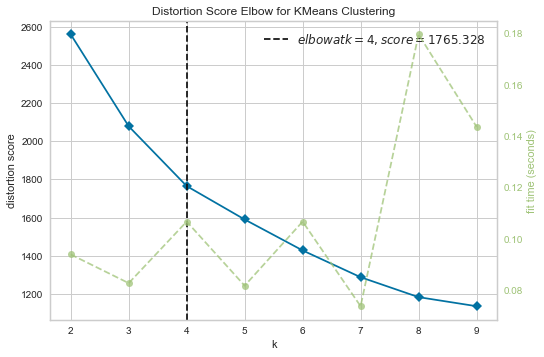

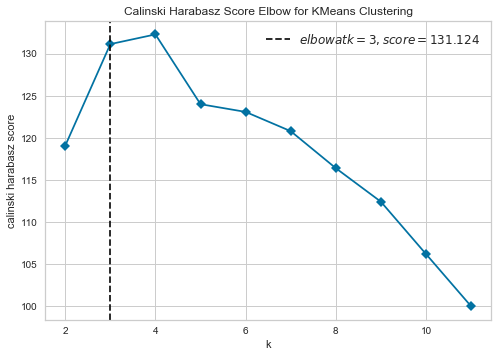

In [58]:
from yellowbrick.cluster import KElbowVisualizer
# Instantiate the clustering model and visualizer
model = KMeans()
visualizer = KElbowVisualizer(model, k=(2,10))

visualizer.fit(MCU)        # Fit the data to the visualizer
visualizer.show()        # Finalize and render the figure

visualizer = KElbowVisualizer(model, k=(2,12), metric='calinski_harabasz', timings=False)

visualizer.fit(MCU)        # Fit the data to the visualizer
visualizer.show()        # Finalize and render the figure

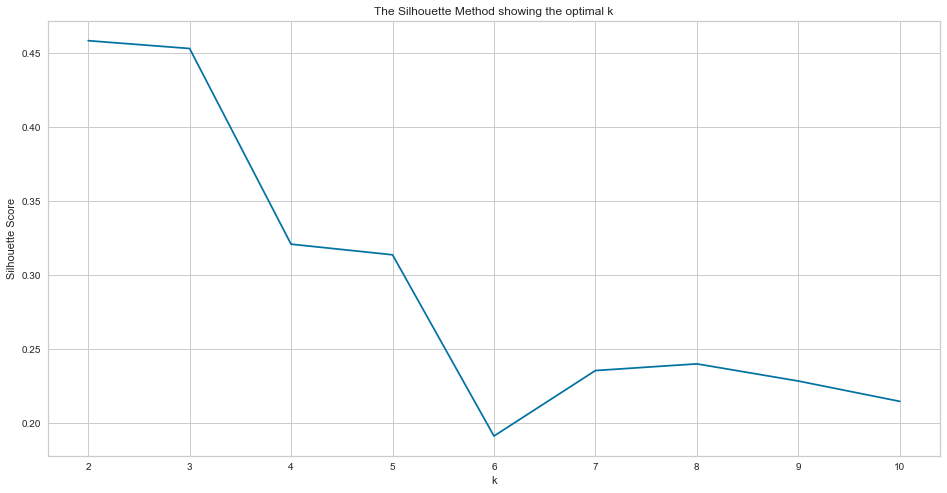

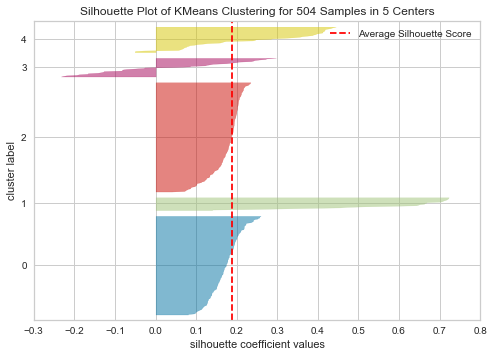

In [59]:
from sklearn.metrics import silhouette_score
from yellowbrick.cluster import SilhouetteVisualizer

sil = []
kmax = 10

# dissimilarity would not be defined for a single cluster, thus, minimum number of clusters should be 2
for k in range(2, kmax+1):
    kmeans = KMeans(n_clusters = k).fit(MCU)
    labels = kmeans.labels_
    sil.append(silhouette_score(MCU, labels, metric = 'euclidean'))

plt.figure(figsize=(16,8))
plt.plot(range(2, kmax+1), sil, 'bx-')
plt.xlabel('k')
plt.ylabel('Silhouette Score')
plt.title('The Silhouette Method showing the optimal k')
plt.show()

model = KMeans(5, random_state=42)
visualizer = SilhouetteVisualizer(model, colors='yellowbrick')

visualizer.fit(MCU)        # Fit the data to the visualizer
visualizer.show()        # Finalize and render the figure

After analyzing the graphs and criteria above we can conclude that the optimal number of lcuster to use is 4, for which we will proceed to study different clustering models

## Selecting clustering model

In [60]:
from sklearn import metrics
from sklearn.preprocessing import StandardScaler

In [61]:
import numpy as np
from sklearn.cluster import KMeans
from typing import Tuple
def get_clusters(X_train: pd.DataFrame, X_test: pd.DataFrame, n_clusters: int) -> Tuple[pd.DataFrame, pd.DataFrame]:
    """
    applies k-means clustering to training data to find clusters and predicts them for the test set
    """
    clustering = KMeans(n_clusters=n_clusters, random_state=8675309)
    clustering.fit(X_train)
    # apply the labels
    train_labels = clustering.labels_
    X_train_clstrs = X_train.copy()
    X_train_clstrs['clusters'] = train_labels
    
    # predict labels on the test set
    test_labels = clustering.predict(X_test)
    X_test_clstrs = X_test.copy()
    X_test_clstrs['clusters'] = test_labels
    return X_train_clstrs, X_test_clstrs

In [62]:
n_clusters = 4
X_train_clstrs, X_test_clstrs = get_clusters(MCU, MCL, n_clusters)
# X_train_clstrs['key'] = MCU.index
labels = X_train_clstrs['clusters']
print('Estimated number of clusters: %d' % n_clusters)
print("Silhouette Coefficient: %0.3f"
      % metrics.silhouette_score(MCU, labels))
print(X_train_clstrs['clusters'].value_counts())
fig = px.scatter_3d(X_train_clstrs, x='Total beneficiarios', y='Valor cofinanciación', z = 'PRODUCTIVIDAD',color='clusters')
fig.show()

Estimated number of clusters: 4
Silhouette Coefficient: 0.321
0    389
1     52
3     38
2     25
Name: clusters, dtype: int64


In [63]:
from sklearn.cluster import AffinityPropagation
clustering = AffinityPropagation(preference=-165, random_state=5).fit(MCU)
cluster_centers_indices = clustering.cluster_centers_indices_
n_clusters_ = len(cluster_centers_indices)
print('Estimated number of clusters: %d' % n_clusters_)
print("Silhouette Coefficient: %0.3f" % metrics.silhouette_score(MCU, clustering.labels_))
X_cluster_AP = MCU.copy()
X_cluster_AP['cluster']=clustering.labels_
print(X_cluster_AP['cluster'].value_counts())
fig = px.scatter_3d(X_cluster_AP, x='Total beneficiarios', y='Valor cofinanciación', z = 'PRODUCTIVIDAD',color='cluster')
fig.show()

Estimated number of clusters: 7
Silhouette Coefficient: 0.233
5    177
3    128
0     81
6     44
4     44
1     25
2      5
Name: cluster, dtype: int64


In [64]:
from sklearn.cluster import DBSCAN
# Compute DBSCAN
db = DBSCAN(eps=0.6, min_samples=5).fit(MCU)
core_samples_mask = np.zeros_like(db.labels_, dtype=bool)
core_samples_mask[db.core_sample_indices_] = True
labels = db.labels_
# Number of clusters in labels, ignoring noise if present.
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
n_noise_ = list(labels).count(-1)

print('Estimated number of clusters: %d' % n_clusters_)
print('Estimated number of noise points: %d' % n_noise_)
print("Silhouette Coefficient: %0.3f"
      % metrics.silhouette_score(MCU, labels))
X_cluster_DB = MCU.copy()
X_cluster_DB['cluster'] = labels
fig = px.scatter_3d(X_cluster_DB, x='Total beneficiarios', y='Valor cofinanciación', z = 'PRODUCTIVIDAD',color='cluster')
fig.show()

Estimated number of clusters: 16
Estimated number of noise points: 330
Silhouette Coefficient: -0.048


In [65]:
from sklearn.cluster import MeanShift
clustering = MeanShift().fit(MCU)
labels = clustering.labels_
# cluster_centers_indices = clustering.cluster_centers_indices_
# n_clusters_ = len(cluster_centers_indices)
print("Silhouette Coefficient: %0.3f"
      % metrics.silhouette_score(MCU, labels))
X_cluster_MS = MCU.copy()
X_cluster_MS['cluster'] = labels
fig = px.scatter_3d(X_cluster_MS, x='Total beneficiarios', y='Valor cofinanciación', z = 'PRODUCTIVIDAD',color='cluster')
fig.show()

Silhouette Coefficient: 0.365


In [66]:
from sklearn.cluster import AgglomerativeClustering
n_clusters_= 4
AC = AgglomerativeClustering(n_clusters=n_clusters_, linkage=
                                     'ward').fit(MCU)
labels = AC.labels_
print('Estimated number of clusters: %d' % n_clusters_)
print("Silhouette Coefficient: %0.3f"
      % metrics.silhouette_score(MCU, labels))
X_cluster_AC = MCU.copy()
X_cluster_AC['cluster'] = labels
print(X_cluster_AC['cluster'].value_counts())
fig = px.scatter_3d(X_cluster_AC, x='Total beneficiarios', y='Valor cofinanciación', z = 'PRODUCTIVIDAD',color='cluster')
fig.show()

Estimated number of clusters: 4
Silhouette Coefficient: 0.314
1    365
0     93
3     23
2     23
Name: cluster, dtype: int64


In [67]:
from sklearn.cluster import Birch
n_clusters_= 4
brc = Birch(n_clusters=n_clusters_).fit(MCU)
labels = brc.labels_
print('Estimated number of clusters: %d' % n_clusters_)
print("Silhouette Coefficient: %0.3f"
      % metrics.silhouette_score(MCU, labels))
X_cluster_BI= MCU.copy()
X_cluster_BI['cluster'] = labels
print(X_cluster_BI['cluster'].value_counts())
fig = px.scatter_3d(X_cluster_BI, x='Total beneficiarios', y='Valor cofinanciación', z = 'PRODUCTIVIDAD',color='cluster')
fig.show()

Estimated number of clusters: 4
Silhouette Coefficient: 0.299
0    425
1     49
3     23
2      7
Name: cluster, dtype: int64


# Behavior within each cluster

In [68]:
import seaborn as sns
cols = ['Total beneficiarios',
       'Valor cofinanciación', 'Valor Contrapartida', 'RENDIMIENTO', 'PRODUCTIVIDAD']

for i in cols:
    fig = px.box(X_train_clstrs, y=i,x='clusters')
    fig.show()

In [69]:
import seaborn as sns
cols = ['Total beneficiarios',
       'Valor cofinanciación', 'Valor Contrapartida', 'RENDIMIENTO', 'PRODUCTIVIDAD']

for i in cols:
    fig = px.box(X_cluster_AC, y=i,x='cluster')
    fig.show()

In [70]:
idx = MCU.index
X5 = X1.iloc[idx].copy()
X5['key'] = idx
print(X5.shape)

(504, 11)


In [71]:
X_cluster_AC ['key']=  X_cluster_AC.index
X_cluster_AC.shape

(504, 77)

In [72]:
MCU_cl = pd.merge(X5, X_cluster_AC[['cluster','key']],on = 'key', how='left')
MCU_cl.shape

(504, 12)

In [73]:
MCU_cl.groupby(['cluster'])[['key']].count()

,key
cluster,
0,93
1,365
2,23
3,23


In [74]:
MCU_cl.groupby(['YEAR'])[['CP']].count()

,CP
YEAR,
2012,65
2013,158
2014,177
2015,59
2016,11
2017,29
2018,2
2019,3


In [75]:
cols = ['Total beneficiarios',
       'Valor cofinanciación', 'Valor Contrapartida', 'YEAR', 'RENDIMIENTO', 'PRODUCTIVIDAD', 'key', 'cluster']
fig = px.imshow(MCU_cl.corr(),x = cols, y = cols)
fig.show()

In [76]:
nc = ['Total beneficiarios',
       'Valor cofinanciación', 'Valor Contrapartida',
      'RENDIMIENTO', 'PRODUCTIVIDAD']

PRUEBA20M = MCU_cl.groupby(['cluster','YEAR']).mean().reset_index()

for i in nc:
    fig = px.line(PRUEBA20M, x="YEAR", y=i,color = 'cluster', title='Total '+i)
    fig.show()

In [77]:
for i in range(0,4):
    fig = px.scatter_3d(MCU_cl[MCU_cl['cluster']==i], x='RENDIMIENTO', y='Valor cofinanciación', z = 'PRODUCTIVIDAD',
                        size='Total beneficiarios', color='cluster', title = 'Cluster '+str(i))
    fig.show()

In [78]:
for i in range(0,4):
    print('Cluster: ',i)
    print(' ')
    lalonde_df = MCU_cl[MCU_cl['cluster']==i].copy()
    display(lalonde_df.describe())
    print(' ')

Cluster:  0
 


,Total beneficiarios,Valor cofinanciación,Valor Contrapartida,YEAR,RENDIMIENTO,PRODUCTIVIDAD,key,cluster
count,93.000000,9.300000e+01,9.300000e+01,93.000000,93.000000,93.000000,93.000000,93.0
mean,141.505376,7.737120e+08,4.083823e+08,2014.483871,9.457235,0.856481,551.505376,0.0
std,113.388963,6.094304e+08,4.459665e+08,1.948315,6.513954,0.165343,335.527153,0.0
min,0.000000,0.000000e+00,0.000000e+00,2012.000000,0.343333,0.344262,0.000000,0.0
25%,70.000000,3.695760e+08,1.732040e+08,2013.000000,5.500000,0.818089,228.000000,0.0
50%,128.000000,5.777042e+08,2.966400e+08,2014.000000,9.000000,0.888889,545.000000,0.0
75%,200.000000,1.000000e+09,4.676648e+08,2017.000000,13.000000,1.000000,888.000000,0.0
max,564.000000,3.618584e+09,3.060630e+09,2019.000000,35.000000,1.000000,1006.000000,0.0


 
Cluster:  1
 


,Total beneficiarios,Valor cofinanciación,Valor Contrapartida,YEAR,RENDIMIENTO,PRODUCTIVIDAD,key,cluster
count,365.000000,3.650000e+02,3.650000e+02,365.000000,365.000000,365.000000,365.000000,365.0
mean,37.189041,1.417447e+08,6.223050e+07,2013.665753,12.711244,0.896771,484.104110,1.0
std,31.892675,1.224549e+08,5.828866e+07,1.098478,9.531953,0.110170,279.453047,0.0
min,0.000000,0.000000e+00,0.000000e+00,2012.000000,0.560000,0.487805,18.000000,1.0
25%,12.000000,5.891805e+07,2.164800e+07,2013.000000,6.500000,0.843172,259.000000,1.0
50%,32.000000,1.108430e+08,4.541375e+07,2014.000000,10.000000,0.916667,486.000000,1.0
75%,56.000000,2.009280e+08,7.910000e+07,2014.000000,15.000000,1.000000,712.000000,1.0
max,160.000000,8.160480e+08,3.276000e+08,2018.000000,60.000000,1.000000,1010.000000,1.0


 
Cluster:  2
 


,Total beneficiarios,Valor cofinanciación,Valor Contrapartida,YEAR,RENDIMIENTO,PRODUCTIVIDAD,key,cluster
count,23.000000,2.300000e+01,2.300000e+01,23.000000,23.000000,23.000000,23.000000,23.0
mean,16.347826,7.674201e+07,3.882751e+07,2013.652174,105.058696,0.857861,332.217391,2.0
std,14.766697,5.713115e+07,3.761903e+07,0.884652,19.565331,0.044729,259.305533,0.0
min,0.000000,0.000000e+00,0.000000e+00,2012.000000,72.510000,0.678571,79.000000,2.0
25%,0.000000,4.148600e+07,9.533940e+06,2013.000000,95.550000,0.856558,133.500000,2.0
50%,16.000000,7.018200e+07,3.287000e+07,2014.000000,110.000000,0.858723,141.000000,2.0
75%,28.000000,1.182701e+08,6.637700e+07,2014.000000,125.430000,0.875150,499.000000,2.0
max,44.000000,1.758780e+08,1.425150e+08,2015.000000,128.910000,0.900966,897.000000,2.0


 
Cluster:  3
 


,Total beneficiarios,Valor cofinanciación,Valor Contrapartida,YEAR,RENDIMIENTO,PRODUCTIVIDAD,key,cluster
count,23.000000,2.300000e+01,2.300000e+01,23.000000,23.00000,23.000000,23.000000,23.0
mean,55.478261,2.365954e+08,8.771781e+07,2013.478261,9.53913,0.320949,486.043478,3.0
std,43.489674,1.897878e+08,6.344033e+07,0.730477,3.41131,0.077788,198.734285,0.0
min,0.000000,0.000000e+00,0.000000e+00,2012.000000,2.00000,0.111111,101.000000,3.0
25%,20.000000,6.380498e+07,3.289488e+07,2013.000000,6.90000,0.278261,331.500000,3.0
50%,48.000000,2.069760e+08,9.099375e+07,2014.000000,10.00000,0.315789,417.000000,3.0
75%,80.000000,3.621968e+08,1.194661e+08,2014.000000,12.00000,0.363636,626.000000,3.0
max,160.000000,6.637602e+08,2.326320e+08,2015.000000,16.00000,0.500000,848.000000,3.0


In [81]:
cols = ['Total beneficiarios', 'Valor cofinanciación','RENDIMIENTO','PRODUCTIVIDAD']
CALIF = pd.DataFrame()
for i in cols:
    y = MCU_cl.groupby(['cluster'])[[i]].mean().sort_values(by = i, ascending = False).reset_index()
    y['cal'] = [4,3,2,1]
    y.columns = ['cluster',i,'cal_'+ str(i)]
    temp = y[['cluster','cal_'+ str(i)]]
    if len(CALIF) == 0:
        CALIF = temp
    else:
        CALIF = pd.merge(CALIF,temp,on='cluster',how ='inner')
        
PESOS = np.array([[0.3],[0.1],[0.2],[0.4]])        
PROBABILIDADES = CALIF.iloc[:,[1,2,3,4]].dot(PESOS)/4
calificaciones = pd.merge(CALIF['cluster'],PROBABILIDADES,right_index=True,left_index=True)

1. Cluster 0 : Aprobado, bueno (BENF = 2, DIN = 1, REND = 4 , PROD = 3)
2. Cluster 1 : No aprobado, regular (BENF = 3, DIN = 4, REND = 1, PROD = 2)
3. Cluster 2: No aprobado, malo (BENF = 1, DIN = 2, REND = 3, PROD = 1)
4. Cluster 3: Aprobado, muy bueno (BENF = 4, DIN = 3, REND = 2, PROD = 4)

BEN = 0,3
DIN = 0,1
REND = 0,2
PROD = 0,4

Multiply the probability of belonging to the cluster vs. the probability that it is approved (fixed subjective)

In [82]:
CALIFICACION = np.array([[2, 1, 4, 3],[3, 4, 1, 2],[1, 2, 3, 1],[4, 3, 2, 4]])
APROBADO = CALIFICACION.dot(PESOS)/4
print(APROBADO)

[[0.675]
 [0.575]
 [0.375]
 [0.875]]


We can see that the third custer is the one with the higgs qualification to according to our ponderation of the variables

Estamos viendo el cluster:  0
En este cluster tenemos en total las siguientes cadenas productivas  36
El top 5 de cadenas productivas es: 
            cluster
CP                 
PLATANO          16
CAFE              8
PIÑA              5
CHONTADURO        5
COCO              5


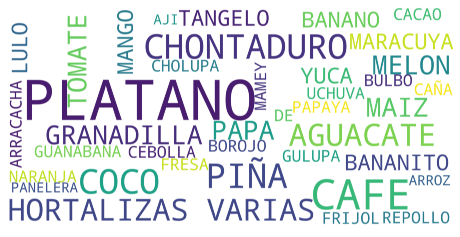

Estamos viendo el cluster:  1
En este cluster tenemos en total las siguientes cadenas productivas  49
El top 5 de cadenas productivas es: 
          cluster
CP               
YUCA           42
ÑAME           35
PLATANO        27
TOMATE         25
AGUACATE       16


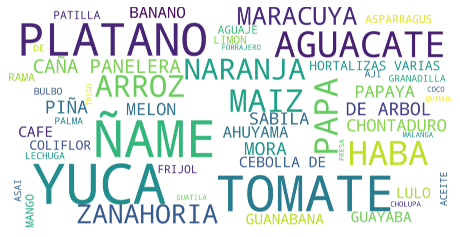

Estamos viendo el cluster:  2
En este cluster tenemos en total las siguientes cadenas productivas  5
El top 5 de cadenas productivas es: 
                cluster
CP                     
CAÑA AZUCARERA       16
PAPAYA                4
MAIZ FORRAJERO        1
PIÑA                  1
TOMATE                1


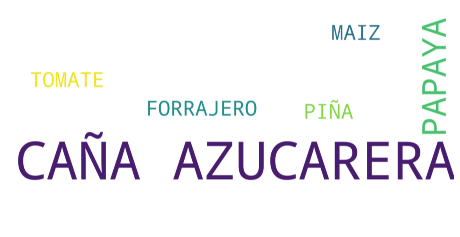

Estamos viendo el cluster:  3
En este cluster tenemos en total las siguientes cadenas productivas  10
El top 5 de cadenas productivas es: 
          cluster
CP               
PLATANO         5
AGUACATE        4
LULO            4
MANGO           3
ÑAME            2


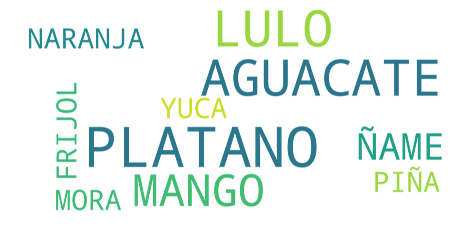

In [83]:
from wordcloud import WordCloud

for i in range(0,4):
    word_cloud_text = ' '.join(MCU_cl[MCU_cl['cluster']==i]['CP'])
    wordcloud = WordCloud(
        max_font_size=100,
        max_words=100,
        background_color="white",
        scale=10,
        width=800,
        height=400
    ).generate(word_cloud_text)
    plt.figure()
    plt.imshow(wordcloud, interpolation="bilinear")
    plt.axis("off")
    print('Estamos viendo el cluster: ',i)
    print('En este cluster tenemos en total las siguientes cadenas productivas ',len(MCU_cl[MCU_cl['cluster']==i]['CP'].unique()))
    print('El top 5 de cadenas productivas es: ')
    print(MCU_cl[MCU_cl['cluster']==i].groupby(['CP'])[['cluster']].count().sort_values(by='cluster',ascending=False).head(5))
    plt.show()

Here we can conclude and solve our business question on what production chain should be financed in the following years, Aguacate, Platano, Frijol, Naranja, Mango y Piña

## Predict clusters of test data

We assign the clusters for the test dataset in order to predict them in a classification algorithm and to be able to test them later.

In [84]:
MCL_cluster = MCL.copy()
MCL_cluster['cluster'] = AC.fit_predict(MCL)

In [85]:
idx = MCL.index
X6 = X1.iloc[idx].copy()
X6['key'] = idx
print(X6.shape)

(505, 11)


In [86]:
MCL_cluster['key'] = MCL_cluster.index
MCL_cluster.shape

(505, 77)

In [87]:
MCL_cl = pd.merge(X6, MCL_cluster[['cluster','key']],on = 'key', how='left')
MCL_cl.shape

(505, 12)

In [88]:
MCL_cl['cluster'].value_counts()

1    389
3     68
0     26
2     22
Name: cluster, dtype: int64

# Classification model

We will perform a classification algorithm to determine the probability of being classified in a certain cluster, which will allow us to know according to the cluster how important it is for ADR according to the weight of the variables of each project.

In [90]:
X = MCL_cluster.drop(columns = ['cluster','key'])
y = MCL_cluster['cluster']

In [91]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.4, random_state=42)

In [92]:
y_test.value_counts()

1    145
3     32
0     14
2     11
Name: cluster, dtype: int64

In [93]:
 y_train.value_counts()

1    244
3     36
0     12
2     11
Name: cluster, dtype: int64

## Choosing the classification model

In [98]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_validate

forest_train_scores_mean = []
forest_train_scores_std = []
forest_test_scores_mean = []
forest_test_scores_std = []

estimadores = np.arange(1,50,1)

for estimador in estimadores:
    clf = RandomForestClassifier(n_estimators=estimador)
    forest_scores = cross_validate(clf, X_train, y_train, cv=5, return_train_score=True, n_jobs = -1)
    
    forest_train_scores_mean.append(forest_scores['train_score'].mean())
    forest_train_scores_std.append(forest_scores['train_score'].std())
    
    forest_test_scores_mean.append(forest_scores['test_score'].mean())
    forest_test_scores_std.append(forest_scores['test_score'].std())

forest_train_scores_mean = np.array(forest_train_scores_mean)
forest_train_scores_std = np.array(forest_train_scores_std)
forest_test_scores_mean = np.array(forest_test_scores_mean)
forest_test_scores_std = np.array(forest_test_scores_std)

()

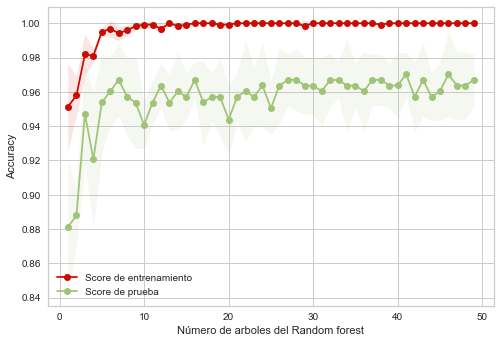

In [99]:
plt.fill_between(estimadores, forest_train_scores_mean - forest_train_scores_std,
                 forest_train_scores_mean + forest_train_scores_std, alpha=0.1,
                 color="r")
plt.fill_between(estimadores, forest_test_scores_mean - forest_test_scores_std,
                 forest_test_scores_mean + forest_test_scores_std, alpha=0.1, color="g")

plt.plot(estimadores, forest_train_scores_mean, 'o-', color="r",
         label="Score de entrenamiento")
plt.plot(estimadores, forest_test_scores_mean, 'o-', color="g",
         label="Score de prueba")


plt.legend()
plt.ylabel('Accuracy')
plt.xlabel('Número de arboles del Random forest')
plt.show
()

In [100]:
rf = RandomForestClassifier(n_estimators=10)
rf.fit(X_train, y_train)
y_pred = rf.predict(X_test)
y_prob = rf.predict_proba(X_test)
print (metrics.classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       1.00      0.79      0.88        14
           1       0.89      0.99      0.94       145
           2       1.00      0.55      0.71        11
           3       0.91      0.66      0.76        32

    accuracy                           0.90       202
   macro avg       0.95      0.75      0.82       202
weighted avg       0.91      0.90      0.89       202



The results allow us to show that our model presents a very good fit to classify the type of project from the test data set. It is important to clarify that the random forest allows us to know the probability of classifying each project in a cluster.

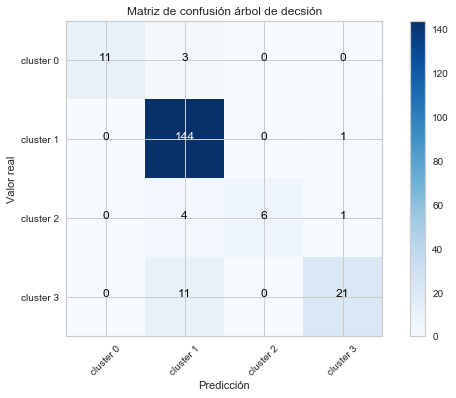

In [101]:
##Funció para gráficar la matriz de confusión
import itertools
def plot_confusion_matrix(cm, classes,title,cmap=plt.cm.Blues):

    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)
    
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], 'd'),
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('Valor real')
    plt.xlabel('Predicción')

cm_ad = metrics.confusion_matrix(y_test, y_pred)
plt.figure()
plot_confusion_matrix(cm_ad, classes=['cluster 0','cluster 1', 'cluster 2','cluster 3'], title='Matriz de confusión árbol de decsión')

We see no additional reasons to study other classification models and we believe that random forest fits well with our requirements.

# Test de los resultados 

In [102]:
APROBADO

array([[0.675],
       [0.575],
       [0.375],
       [0.875]])

In [103]:
y_prob[3]

array([0., 1., 0., 0.])

In [104]:
y_pred[3]

1

In [105]:
PROBABILIDAD_APROBADO = y_prob[3]*APROBADO.T
PROBABILIDAD_APROBADO.max()*100

57.49999999999999

Our classification model returns the probability of belonging to a cluster and with this we calculate the probability of success based on the cluster to which each project is expected to belong.

# Conclusions

We develop a clustering model to classify historical projects, according to variables of each project and the conditions of the production chains to which each of them belonged, for these we carry out tasks of text preprocessing, classification of categorical variables, forecasts and prescriptive statistics. As a result, we obtained the probability that a new project is highly profitable and of high impact on society.